<a href="https://colab.research.google.com/github/CamHerr/my-first-web/blob/main/Project_Wagon_lastVersion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
import datetime

In [5]:
!pip install greykite

# 1.Analyse Exploratoire
## 1.1 Nettoyage du dataframe

In [6]:
#Import dataset on energy
df = pd.read_csv('/content/drive/MyDrive/energy_dataset.csv')
df.head(10)

,time,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
0,2015-01-01 00:00:00+01:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,...,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
1,2015-01-01 01:00:00+01:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,...,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2,2015-01-01 02:00:00+01:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,...,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48
3,2015-01-01 03:00:00+01:00,438.0,254.0,0.0,4314.0,4131.0,160.0,0.0,0.0,0.0,...,191.0,0.0,5238.0,2.0,NaN,5151.0,22642.0,21286.0,42.27,59.32
4,2015-01-01 04:00:00+01:00,428.0,187.0,0.0,4130.0,3840.0,156.0,0.0,0.0,0.0,...,189.0,0.0,4935.0,9.0,NaN,4861.0,21785.0,20264.0,38.41,56.04
5,2015-01-01 05:00:00+01:00,410.0,178.0,0.0,4038.0,3590.0,156.0,0.0,0.0,0.0,...,188.0,0.0,4618.0,4.0,NaN,4617.0,21441.0,19905.0,35.72,53.63
6,2015-01-01 06:00:00+01:00,401.0,172.0,0.0,4040.0,3368.0,158.0,0.0,0.0,0.0,...,186.0,0.0,4397.0,3.0,NaN,4276.0,21285.0,20010.0,35.13,51.73
7,2015-01-01 07:00:00+01:00,408.0,172.0,0.0,4030.0,3208.0,160.0,0.0,0.0,0.0,...,189.0,0.0,3992.0,12.0,NaN,3994.0,21545.0,20377.0,36.22,51.43
8,2015-01-01 08:00:00+01:00,413.0,177.0,0.0,4052.0,3335.0,161.0,0.0,0.0,0.0,...,198.0,0.0,3629.0,39.0,NaN,3602.0,21443.0,20094.0,32.40,48.98
9,2015-01-01 09:00:00+01:00,419.0,177.0,0.0,4137.0,3437.0,163.0,0.0,0.0,0.0,...,198.0,0.0,3073.0,784.0,NaN,3212.0,21560.0,20637.0,36.60,54.20


In [7]:
#Conversion de la colonne 'time' au format datetime en gardant les heures
df['time'] = pd.to_datetime(df['time'], utc=True, format='%Y-%m-%d %H:%M:%S%z')
#Supprimer les fudeaux horaires
df['time'] = pd.to_datetime(df['time'], utc=True).dt.tz_localize(None)
#Remplacer l'index par la colonne 'time'
#df.set_index('time', inplace=True)
df.head()

,time,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
0,2014-12-31 23:00:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,...,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
1,2015-01-01 00:00:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,...,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2,2015-01-01 01:00:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,...,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48
3,2015-01-01 02:00:00,438.0,254.0,0.0,4314.0,4131.0,160.0,0.0,0.0,0.0,...,191.0,0.0,5238.0,2.0,NaN,5151.0,22642.0,21286.0,42.27,59.32
4,2015-01-01 03:00:00,428.0,187.0,0.0,4130.0,3840.0,156.0,0.0,0.0,0.0,...,189.0,0.0,4935.0,9.0,NaN,4861.0,21785.0,20264.0,38.41,56.04


In [8]:
#Supprimer les columnes NULL
df = df.drop(['generation fossil coal-derived gas','generation fossil oil shale','generation fossil peat','generation geothermal','generation hydro pumped storage aggregated','generation marine','generation wind offshore','forecast wind offshore eday ahead'],axis=1)
df

,time,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation fossil oil,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,...,generation other renewable,generation solar,generation waste,generation wind onshore,forecast solar day ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
0,2014-12-31 23:00:00,447.0,329.0,4844.0,4821.0,162.0,863.0,1051.0,1899.0,7096.0,...,73.0,49.0,196.0,6378.0,17.0,6436.0,26118.0,25385.0,50.10,65.41
1,2015-01-01 00:00:00,449.0,328.0,5196.0,4755.0,158.0,920.0,1009.0,1658.0,7096.0,...,71.0,50.0,195.0,5890.0,16.0,5856.0,24934.0,24382.0,48.10,64.92
2,2015-01-01 01:00:00,448.0,323.0,4857.0,4581.0,157.0,1164.0,973.0,1371.0,7099.0,...,73.0,50.0,196.0,5461.0,8.0,5454.0,23515.0,22734.0,47.33,64.48
3,2015-01-01 02:00:00,438.0,254.0,4314.0,4131.0,160.0,1503.0,949.0,779.0,7098.0,...,75.0,50.0,191.0,5238.0,2.0,5151.0,22642.0,21286.0,42.27,59.32
4,2015-01-01 03:00:00,428.0,187.0,4130.0,3840.0,156.0,1826.0,953.0,720.0,7097.0,...,74.0,42.0,189.0,4935.0,9.0,4861.0,21785.0,20264.0,38.41,56.04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35059,2018-12-31 18:00:00,297.0,0.0,7634.0,2628.0,178.0,1.0,1135.0,4836.0,6073.0,...,95.0,85.0,277.0,3113.0,96.0,3253.0,30619.0,30653.0,68.85,77.02
35060,2018-12-31 19:00:00,296.0,0.0,7241.0,2566.0,174.0,1.0,1172.0,3931.0,6074.0,...,95.0,33.0,280.0,3288.0,51.0,3353.0,29932.0,29735.0,68.40,76.16
35061,2018-12-31 20:00:00,292.0,0.0,7025.0,2422.0,168.0,50.0,1148.0,2831.0,6076.0,...,94.0,31.0,286.0,3503.0,36.0,3404.0,27903.0,28071.0,66.88,74.30
35062,2018-12-31 21:00:00,293.0,0.0,6562.0,2293.0,163.0,108.0,1128.0,2068.0,6075.0,...,93.0,31.0,287.0,3586.0,29.0,3273.0,25450.0,25801.0,63.93,69.89


## 1.2 Vizualisation de la donnée

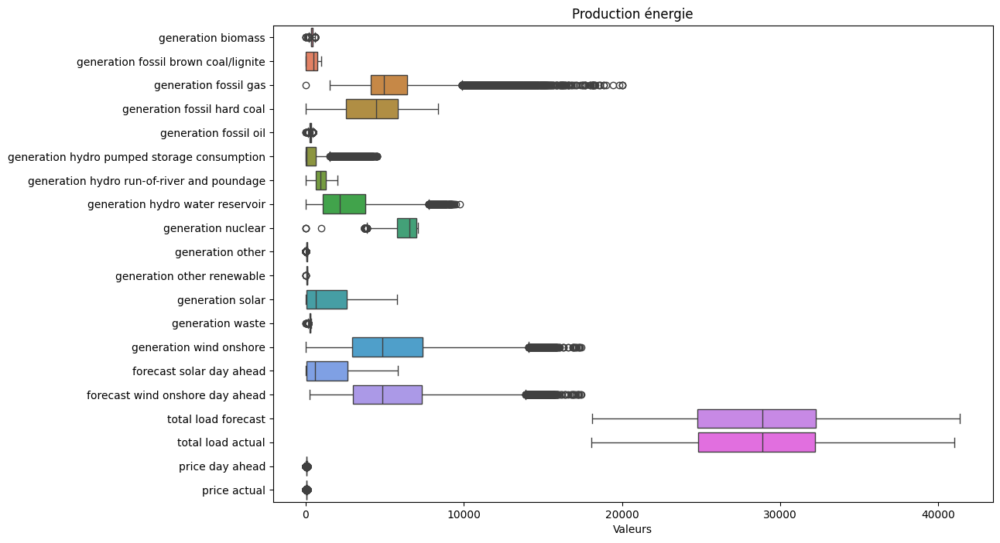

In [9]:
# Sélectionner les colonnes numériques pertinentes pour l'analyse (par exemple)
numeric_columns = df.select_dtypes(include='number')
# Afficher une série de boîtes à moustaches pour les colonnes sélectionnées
plt.figure(figsize=(12, 8))
sns.boxplot(data=numeric_columns, orient='h') #orient='h' pour des boîtes horizontales
plt.title('Production énergie')
plt.xlabel('Valeurs')
plt.show()

**Observations**



*   Plusieurs variables comportent des outliers
*   La colonne 'total load actual' ne semble pas impacter par ces outliers




In [10]:
fig = px.line(df['generation fossil gas'], title = 'Observation source énergie comportant des outliers')
fig.show()

Exemple d'outlier:
  Date 2 juin 2018, valeur = 0

In [11]:
fig = px.line(df['total load actual'], title = 'Observation production générale énergie')
fig.show()

## 1.3 Analyse préalable du jeu de données

### Période donnée

Période qui s'étend sur 4 ans, de janvier 2015 à janvier 2019.
Assez de saisonnalité pour produire une prévision.

### Période Atypique


*   Outliers récurrents dans plusieurs variables sources d'énergie aux dates du 12/14 novembre 2017 et 6 mai 2018 = mise à part une grosse crise politique au cours du mois de novembre , pas d'explications tangibles.

Sources d'énergie concernées:


1.   Fossil hard coal
2.   Biomass
3.   Fossil Oil
4.   Hydro run of river and poundage
5.   Nuclear
6.   Other Renwable
7.   Waste

*   Données sur une période pré-Covid



### Saisonnalité



*   On observe une saisonnalité mensuelle avec des rythmes diffèrents d'une source d'énergie à une autre.
*  On ne remarque pas de dynamique récurrente notable au plan annuel


# 2. Modélisation
##2.1 Modélisation avec Silverkite

In [12]:
#Première modélisation avec Greykite

from greykite.framework.templates.autogen.forecast_config import ForecastConfig, MetadataParam

forecast_config = ForecastConfig(
    model_template = "SILVERKITE",
    forecast_horizon = 365*24,
    coverage = 0.95,
    metadata_param = MetadataParam(
      time_col = 'time',
      value_col = "total load actual",
      freq = "H",
      train_end_date=datetime.datetime(2017, 3, 4)
   )
)

In [49]:
from greykite.framework.templates.forecaster import Forecaster

forecaster = Forecaster()

silverkite = forecaster.run_forecast_config(
    df = df,
    config = forecast_config
)

Fitting 1 folds for each of 1 candidates, totalling 1 fits


/usr/local/lib/python3.10/dist-packages/greykite/sklearn/cross_validation.py:191: UserWarning:

There are no CV splits under the requested settings. Decrease `forecast_horizon` and/or `min_train_periods`. Using default 90/10 CV split



In [62]:
silverkite.forecast.plot()

On peut observer que la modèle de prédiction est plutôt satisfant. Quelques exceptions sur les pics de valeurs hautes qui sont sous évaluer dans le modèle de prédiction.

In [53]:
silverkite.forecast.test_evaluation['sMAPE']

3.6539734494375615

La SMAPE est de 3,6%, ce qui est bon (3,6% de la consommation d'énergie mal prédit sur 24h)

In [42]:
df['total load actual'].isna().sum()

17

In [37]:
# Remplacer les valeurs manquantes par la moyenne des deux valeurs encadrants la valeur manquante
for i in range(len(df)):
    if pd.isna(df['total load actual'][i]):
        # Gestio des valeurs debut et fin du dataframe
        if i == 0:  # Si valeur manquante en début de dataframe
            df['total load actual'][i] = df['total load actual'][i+1]
        elif i == len(df) - 1:  # Si valeur manquante en fin de dataframe
            df['total load actual'][i] = df['total load actual'][i-1]
        else:
            # Calcul de la moyenne des valeurs encadrantes
            avg_surrounding = (df['total load actual'][i-1] + df['total load actual'][i+1]) / 2
            df['total load actual'][i] = avg_surrounding
df['total load actual'].isna().sum()

17

In [51]:
#Conversion des valeurs Nan restantes
nan_values = df[df['total load actual'].isna()]
print("NaN values after conversion:", nan_values)

# Replace NaN values with a specific value or method (e.g., mean)
# For example, replace NaN with the mean of the column
mean_value = df['total load actual'].mean()
df['total load actual'].fillna(mean_value, inplace=True)

# Alternatively, you can replace NaN with a specific value, such as 0
# df['total load actual'].fillna(0, inplace=True)

# Check for NaN values after replacement
nan_values_after_replacement = df[df['total load actual'].isna()]
print("NaN values after replacement:", nan_values_after_replacement)

NaN values after conversion: Empty DataFrame
Columns: [time, generation biomass, generation fossil brown coal/lignite, generation fossil gas, generation fossil hard coal, generation fossil oil, generation hydro pumped storage consumption, generation hydro run-of-river and poundage, generation hydro water reservoir, generation nuclear, generation other, generation other renewable, generation solar, generation waste, generation wind onshore, forecast solar day ahead, forecast wind onshore day ahead, total load forecast, total load actual, price day ahead, price actual]
Index: []

[0 rows x 21 columns]
NaN values after replacement: Empty DataFrame
Columns: [time, generation biomass, generation fossil brown coal/lignite, generation fossil gas, generation fossil hard coal, generation fossil oil, generation hydro pumped storage consumption, generation hydro run-of-river and poundage, generation hydro water reservoir, generation nuclear, generation other, generation other renewable, generatio

In [52]:
df['total load actual'].isna().sum()

0

### Modélisation avec Greykite en ajoutant les données météorologiques

In [54]:
#Ajout de la dataframe avec données météorologiques
meteo = pd.read_csv('/content/drive/MyDrive/weather_features.csv')
meteo['dt_iso'] = pd.to_datetime(meteo['dt_iso'], utc=True, format='%Y-%m-%d %H:%M:%S%z')
#Supprimer les fudeaux horaires
meteo['dt_iso'] = pd.to_datetime(meteo['dt_iso'], utc=True).dt.tz_localize(None)

meteo.head(2)

,dt_iso,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,2014-12-31 23:00:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
1,2015-01-01 00:00:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n


In [55]:
#Jointure entre les deux dataframe
df = df.merge(meteo, how='left', left_on='time', right_on='dt_iso').drop(columns='dt_iso')
df

,time,generation biomass,generation fossil brown coal/lignite,generation fossil gas,generation fossil hard coal,generation fossil oil,generation hydro pumped storage consumption,generation hydro run-of-river and poundage,generation hydro water reservoir,generation nuclear,...,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,2014-12-31 23:00:00,447.0,329.0,4844.0,4821.0,162.0,863.0,1051.0,1899.0,7096.0,...,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
1,2014-12-31 23:00:00,447.0,329.0,4844.0,4821.0,162.0,863.0,1051.0,1899.0,7096.0,...,1,309,0.0,0.0,0.0,0,800,clear,sky is clear,01n
2,2014-12-31 23:00:00,447.0,329.0,4844.0,4821.0,162.0,863.0,1051.0,1899.0,7096.0,...,0,226,0.0,0.0,0.0,0,800,clear,sky is clear,1
3,2014-12-31 23:00:00,447.0,329.0,4844.0,4821.0,162.0,863.0,1051.0,1899.0,7096.0,...,7,58,0.0,0.0,0.0,0,800,clear,sky is clear,01n
4,2014-12-31 23:00:00,447.0,329.0,4844.0,4821.0,162.0,863.0,1051.0,1899.0,7096.0,...,1,21,0.0,0.0,0.0,0,800,clear,sky is clear,01n
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178391,2018-12-31 22:00:00,290.0,0.0,6926.0,2166.0,163.0,108.0,1069.0,1686.0,6075.0,...,2,300,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178392,2018-12-31 22:00:00,290.0,0.0,6926.0,2166.0,163.0,108.0,1069.0,1686.0,6075.0,...,1,360,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178393,2018-12-31 22:00:00,290.0,0.0,6926.0,2166.0,163.0,108.0,1069.0,1686.0,6075.0,...,2,100,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178394,2018-12-31 22:00:00,290.0,0.0,6926.0,2166.0,163.0,108.0,1069.0,1686.0,6075.0,...,5,310,0.0,0.0,0.0,0,800,clear,sky is clear,01n


In [60]:
from greykite.framework.templates.autogen.forecast_config import ModelComponentsParam

#Ajout de nouveaux paramètres météorologiques
custom_silverkite = ModelComponentsParam(
    regressors={
        "regressor_cols": [
            "temp",
            "humidity",
            "wind_speed",
            "wind_deg",
            "rain_1h",
            "rain_3h",
            "snow_3h",
            "clouds_all"
        ]
    }
)


In [61]:
forecast_config = ForecastConfig(
    model_template = "SILVERKITE",
    forecast_horizon = 365*24,
    coverage = 0.95,
    model_components_param = custom_silverkite,
    metadata_param = MetadataParam(
      time_col = "time",
      value_col = "total load actual",
      freq = "H",
      train_end_date=datetime.datetime(2017, 3, 4)
   )
)

silverkite = forecaster.run_forecast_config(
    df = df,
    config = forecast_config
)

/usr/local/lib/python3.10/dist-packages/greykite/common/time_properties.py:352: UserWarning:

Duplicate timestamps have been removed.

/usr/local/lib/python3.10/dist-packages/greykite/common/time_properties.py:352: UserWarning:

Duplicate timestamps have been removed.



Fitting 1 folds for each of 1 candidates, totalling 1 fits


/usr/local/lib/python3.10/dist-packages/greykite/sklearn/cross_validation.py:191: UserWarning:

There are no CV splits under the requested settings. Decrease `forecast_horizon` and/or `min_train_periods`. Using default 90/10 CV split



In [89]:
silverkite.forecast.plot()

In [64]:
silverkite.forecast.test_evaluation['sMAPE']

3.6587839391182126

Le modèle se détériore très légèrement en SMAPE,après les données météorologiques. Cela est toutefois très limité, de l'ordre de 0,5 %, ce qui montre que la météo (telle qu'elle est intégrée) n'est pas un facteur déterminant pour la consommation d'énergie.

##2.2 Modélisation avec Prophet

In [65]:
#Entraînement du modèle avec Prophet
forecast_config = ForecastConfig(
    model_template = "PROPHET",
    forecast_horizon = 365*24,
    coverage = 0.95,
    metadata_param = MetadataParam(
      time_col = "time",
      value_col = "total load actual",
      freq = "H",
      train_end_date=datetime.datetime(2017, 3, 4)
   )
)

forecaster = Forecaster()

prophet = forecaster.run_forecast_config(
    df = df,
    config = forecast_config
)

/usr/local/lib/python3.10/dist-packages/greykite/common/time_properties.py:352: UserWarning:

Duplicate timestamps have been removed.

/usr/local/lib/python3.10/dist-packages/greykite/common/time_properties.py:352: UserWarning:

Duplicate timestamps have been removed.

/usr/local/lib/python3.10/dist-packages/greykite/sklearn/cross_validation.py:191: UserWarning:

There are no CV splits under the requested settings. Decrease `forecast_horizon` and/or `min_train_periods`. Using default 90/10 CV split

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Fitting 1 folds for each of 1 candidates, totalling 1 fits


DEBUG:cmdstanpy:input tempfile: /tmp/tmpn3ab1l2f/ic8m_brx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpn3ab1l2f/ygwxp9q8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55618', 'data', 'file=/tmp/tmpn3ab1l2f/ic8m_brx.json', 'init=/tmp/tmpn3ab1l2f/ygwxp9q8.json', 'output', 'file=/tmp/tmpn3ab1l2f/prophet_modelg0jqj9pr/prophet_model-20240514153507.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
15:35:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
15:35:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpn3ab1l2f/_ab5s817.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpn3ab1l2f/p2thhcqv.json
DEBUG:cmdstanp

In [66]:
prophet.forecast.plot()

In [67]:
prophet.forecast.test_evaluation['sMAPE']

4.666109721113947

Les deux algorithmes sont bons. Ils offrent des performances similaires.On observe un **très léger avantage pour Silverkite** au vu de la SMAPE, avec une différence de 0,95%.

### Modélisation avec Prophet en ajoutant les données météorologiques

In [85]:
from greykite.framework.templates.autogen.forecast_config import ForecastConfig, MetadataParam, ModelComponentsParam
import datetime

# Define custom model components for Prophet
custom_prophet = ModelComponentsParam(
    regressors={
        "add_regressor_dict": {
            "temp": {},
            "humidity": {},
            "wind_speed": {},
            "wind_deg": {},
            "rain_1h": {},
            "rain_3h": {},
            "snow_3h": {},
            "clouds_all": {}
        }
    }
)


# Define the forecasting configuration
forecast_config = ForecastConfig(
    model_template="PROPHET",
    forecast_horizon=365*24,
    coverage=0.95,
    model_components_param=custom_prophet,
    metadata_param=MetadataParam(
        time_col="time",
        value_col="total load actual",
        freq="H",
        train_end_date=datetime.datetime(2017, 3, 4),
    )
)

# Run the forecast using the configured settings
prophet_forecast = forecaster.run_forecast_config(
    df=df,
    config=forecast_config
)

/usr/local/lib/python3.10/dist-packages/greykite/common/time_properties.py:352: UserWarning:

Duplicate timestamps have been removed.

/usr/local/lib/python3.10/dist-packages/greykite/common/time_properties.py:352: UserWarning:

Duplicate timestamps have been removed.

/usr/local/lib/python3.10/dist-packages/greykite/sklearn/cross_validation.py:191: UserWarning:

There are no CV splits under the requested settings. Decrease `forecast_horizon` and/or `min_train_periods`. Using default 90/10 CV split

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


Fitting 1 folds for each of 1 candidates, totalling 1 fits


DEBUG:cmdstanpy:input tempfile: /tmp/tmpn3ab1l2f/m5f4j129.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpn3ab1l2f/8q2vls5n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73508', 'data', 'file=/tmp/tmpn3ab1l2f/m5f4j129.json', 'init=/tmp/tmpn3ab1l2f/8q2vls5n.json', 'output', 'file=/tmp/tmpn3ab1l2f/prophet_model1xi9trn7/prophet_model-20240514162456.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
16:24:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
16:25:21 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpn3ab1l2f/g18t8bnu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpn3ab1l2f/vtrr8u75.json
DEBUG:cmdstanp

In [86]:
prophet.forecast.plot()

In [87]:
prophet.forecast.test_evaluation['sMAPE']

4.666109721113947

Il semble que les données météorologiques n'est en rien impacté la prévision établie par Prophet au vue de SMAP identiques.

##2.3 Prédiction de la consommation d'énergie pour l'année 2019
Le modèle Silverkite ayant produit une meilleure prévision que le modèle Prophet, nouw allons utiliser celui-là pour prédire la consommation d'énergie en Espagne pour l'année 2019. L'ajout des données météorologiques ayant un impact négatif sur la prévision, nous exclureons ces paramètres.

In [91]:
from greykite.framework.templates.autogen.forecast_config import ForecastConfig, MetadataParam

forecast_config = ForecastConfig(
    model_template = "SILVERKITE",
    forecast_horizon = 365*24,
    coverage = 0.95,
    metadata_param = MetadataParam(
      time_col = 'time',
      value_col = "total load actual",
      freq = "H",
      train_end_date=datetime.datetime(2018, 12, 31)
   )
)

from greykite.framework.templates.forecaster import Forecaster

forecaster = Forecaster()

silverkite = forecaster.run_forecast_config(
    df = df,
    config = forecast_config
)

/usr/local/lib/python3.10/dist-packages/greykite/common/time_properties.py:352: UserWarning:

Duplicate timestamps have been removed.

/usr/local/lib/python3.10/dist-packages/greykite/common/time_properties.py:352: UserWarning:

Duplicate timestamps have been removed.



Fitting 1 folds for each of 1 candidates, totalling 1 fits


/usr/local/lib/python3.10/dist-packages/greykite/sklearn/cross_validation.py:194: UserWarning:

There is only one CV split

/usr/local/lib/python3.10/dist-packages/greykite/sklearn/transform/null_transformer.py:177: RuntimeWarning:

Input data has many null values. Missing 19.95% of one input.

/usr/local/lib/python3.10/dist-packages/greykite/common/evaluation.py:153: UserWarning:

8738 value(s) in y_true were NA or infinite and are omitted in error calc.

/usr/local/lib/python3.10/dist-packages/greykite/common/evaluation.py:153: UserWarning:

8738 value(s) in y_true were NA or infinite and are omitted in error calc.



In [92]:
silverkite.forecast.plot()

**Résultat de la Prédiction**

Au vue de la prédiction établie avec le modèle Silverkite, nous pouvons établir une analyse de la consommation d'énergie des 5 plus grandes villes d'Espagne pour l'année 2019.

Les principaux faits à noter sont les suivants:


*   Baisse prévisionnelle notable de la consommation d'énergie entre janvier 2019 et avril 2019
*   Nouveau pic prévisionnel observé en juillet 2019
*   Nouvelle baisse prévisionnelle en Novembre 2019 et remontée en fin d'année de la consommation d'énergie


Baisse prévisionnelle notable de la consommation d'énergie entre janvier 2019 et avril 2019

